In [2]:
import pandas as pd
import numpy as np
import tensorflow as tf
from tensorflow import keras
import matplotlib.pyplot as plt
import os
import PIL
from IPython.display import display

# New section

In [3]:
!mkdir -p ~/.kaggle
!mv kaggle.json ~/.kaggle
!chmod 660 ~/.kaggle/kaggle.json


In [4]:
#!/bin/bash
!kaggle datasets download ichhadhari/leaf-images

Dataset URL: https://www.kaggle.com/datasets/ichhadhari/leaf-images
License(s): copyright-authors
100% 5.29G/5.29G [01:23<00:00, 15.2MB/s]
100% 5.29G/5.29G [01:23<00:00, 68.4MB/s]


In [5]:
!unzip leaf-images.zip

Archive:  leaf-images.zip
  inflating: 300_dataset/Apta/1.jpg  
  inflating: 300_dataset/Apta/10.jpg  
  inflating: 300_dataset/Apta/100.jpg  
  inflating: 300_dataset/Apta/101.jpg  
  inflating: 300_dataset/Apta/102.jpg  
  inflating: 300_dataset/Apta/103.jpg  
  inflating: 300_dataset/Apta/104.jpg  
  inflating: 300_dataset/Apta/105.jpg  
  inflating: 300_dataset/Apta/106.jpg  
  inflating: 300_dataset/Apta/107.jpg  
  inflating: 300_dataset/Apta/108.jpg  
  inflating: 300_dataset/Apta/109.jpg  
  inflating: 300_dataset/Apta/11.jpg  
  inflating: 300_dataset/Apta/110.jpg  
  inflating: 300_dataset/Apta/111.jpg  
  inflating: 300_dataset/Apta/112.jpg  
  inflating: 300_dataset/Apta/113.jpg  
  inflating: 300_dataset/Apta/114.jpg  
  inflating: 300_dataset/Apta/115.jpg  
  inflating: 300_dataset/Apta/116.jpg  
  inflating: 300_dataset/Apta/117.jpg  
  inflating: 300_dataset/Apta/118.jpg  
  inflating: 300_dataset/Apta/119.jpg  
  inflating: 300_dataset/Apta/12.jpg  
  inflating: 300_da

In [6]:
len(os.listdir('/content/300_dataset/Kashid'))

300

In [7]:
img=PIL.Image.open('/content/300_dataset/Kashid/2.jpg')
img.show()

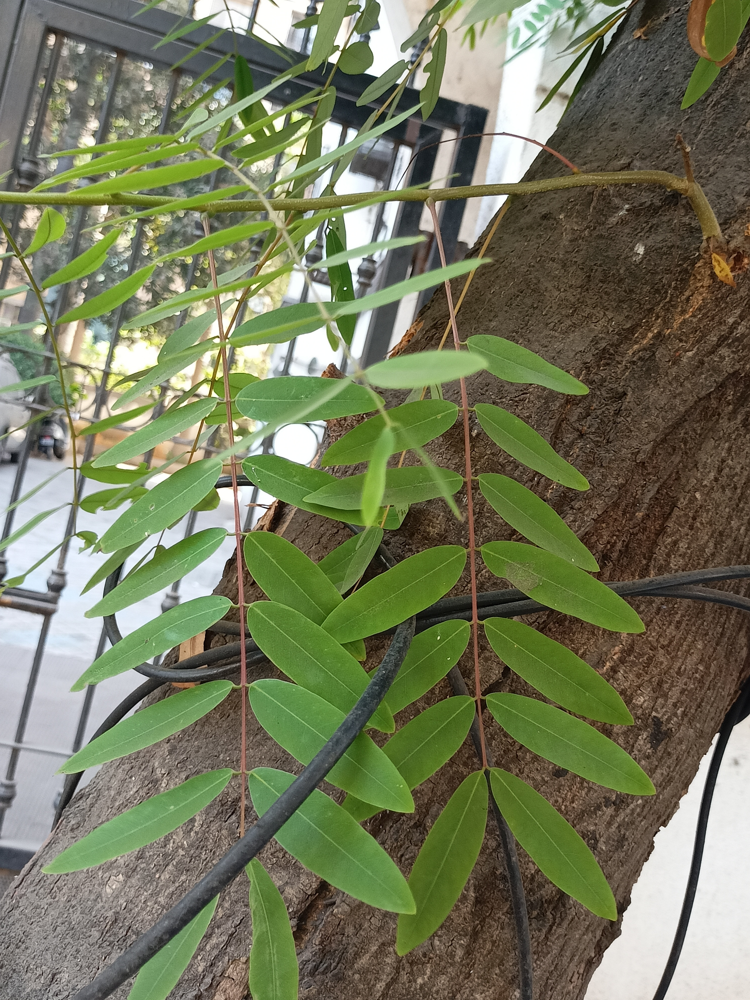

In [8]:
display(img)



In [36]:
import os
from PIL import Image

data_dir = '/content/300_dataset'
supported_formats = ['jpg', 'jpeg', 'png', 'bmp', 'gif']

for subdir, dirs, files in os.walk(data_dir):
    for file in files:
        filepath = os.path.join(subdir, file)
        try:
            img = Image.open(filepath)
            img.verify()
        except (IOError, SyntaxError, Image.UnidentifiedImageError) as e:
            print(f"Removing problematic file: {filepath} - {e}")
            os.remove(filepath)

Removing problematic file: /content/300_dataset/Vad/301.jpg - cannot identify image file '/content/300_dataset/Vad/301.jpg'
Removing problematic file: /content/300_dataset/Vilayati Chinch/301.jpg - cannot identify image file '/content/300_dataset/Vilayati Chinch/301.jpg'
Removing problematic file: /content/300_dataset/Sonmohar/301.jpg - cannot identify image file '/content/300_dataset/Sonmohar/301.jpg'


In [37]:
data_gen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1/255,validation_split=0.1,)

In [38]:
train_gen = data_gen.flow_from_directory(subset='training' , directory='/content/300_dataset', target_size=(150, 150), color_mode='rgb', class_mode='sparse', batch_size=32, shuffle=True, seed=None, save_to_dir=None, )

Found 2700 images belonging to 10 classes.


In [39]:
test_gen = data_gen.flow_from_directory(subset='validation' , directory='/content/300_dataset', target_size=(150, 150), color_mode='rgb', class_mode='sparse', batch_size=32, shuffle=True, seed=None, save_to_dir=None, )

Found 300 images belonging to 10 classes.


In [40]:
test_gen.class_indices

{'Apta': 0,
 'Indian Rubber Tree': 1,
 'Karanj': 2,
 'Kashid': 3,
 'Nilgiri': 4,
 'Pimpal': 5,
 'Sita Ashok': 6,
 'Sonmohar': 7,
 'Vad': 8,
 'Vilayati Chinch': 9}

In [48]:
train_gen.image_shape

(150, 150, 3)

In [49]:
from tensorflow import keras

model = keras.Sequential([
    keras.layers.Input(shape=(150,150,3)),

    keras.layers.Conv2D(64,(3,3),padding='same'),
    keras.layers.BatchNormalization(),
    keras.layers.Activation('relu'),
    keras.layers.MaxPooling2D((2,2)),
    keras.layers.Dropout(0.2),

    keras.layers.Conv2D(128,(3,3),padding='same'),
    keras.layers.BatchNormalization(),
    keras.layers.Activation('relu'),
    keras.layers.MaxPooling2D((2,2)),
    keras.layers.Dropout(0.2),

    keras.layers.Conv2D(128,(3,3),padding='same'),
    keras.layers.BatchNormalization(),
    keras.layers.Activation('relu'),
    keras.layers.MaxPooling2D((2,2)),
    keras.layers.Dropout(0.2),

    keras.layers.Flatten(),
    keras.layers.Dense(512, activation='relu'),
    keras.layers.Dropout(0.3),
    keras.layers.Dense(10, activation='softmax')
])


In [50]:
model.summary()

Model: "sequential_8"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_33 (Conv2D)              │ (None, 150, 150, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 150, 150, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_6 (Activation)       │ (None, 150, 150, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_33 (MaxPooling2D) │ (None, 75, 75, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_8 (Dropout)             │ (None, 75, 75, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_34 (Conv2D)              │ (None, 75, 75, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_7           │ (None, 75, 75, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_7 (Activation)       │ (None, 75, 75, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_34 (MaxPooling2D) │ (None, 37, 37, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_9 (Dropout)             │ (None, 37, 37, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_35 (Conv2D)              │ (None, 37, 37, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_8           │ (None, 37, 37, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_8 (Activation)       │ (None, 37, 37, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_35 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_10 (Dropout)            │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_4 (Flatten)             │ (None, 41472)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_20 (Dense)                │ (None, 512)            │    21,234,176 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_11 (Dropout)            │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_21 (Dense)                │ (None, 10)             │         5,130 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 21,463,818 (81.88 MB)

 Trainable params: 21,463,178 (81.88 MB)

 Non-trainable params: 640 (2.50 KB)

In [51]:
model.compile(optimizer='Adam',loss=keras.losses.SparseCategoricalCrossentropy(),metrics=['accuracy'])
model.fit(train_gen ,validation_data=test_gen,epochs=10)

Epoch 1/10
85/85 ━━━━━━━━━━━━━━━━━━━━ 179s 2s/step - accuracy: 0.1439 - loss: 24.2469 - val_accuracy: 0.1167 - val_loss: 2.5291
Epoch 2/10
85/85 ━━━━━━━━━━━━━━━━━━━━ 166s 2s/step - accuracy: 0.1934 - loss: 2.1420 - val_accuracy: 0.0933 - val_loss: 2.3719
Epoch 3/10
85/85 ━━━━━━━━━━━━━━━━━━━━ 161s 2s/step - accuracy: 0.2472 - loss: 2.0002 - val_accuracy: 0.1267 - val_loss: 2.2964
Epoch 4/10
85/85 ━━━━━━━━━━━━━━━━━━━━ 162s 2s/step - accuracy: 0.2674 - loss: 1.9097 - val_accuracy: 0.1200 - val_loss: 2.3376
Epoch 5/10
85/85 ━━━━━━━━━━━━━━━━━━━━ 162s 2s/step - accuracy: 0.3067 - loss: 1.8646 - val_accuracy: 0.0933 - val_loss: 2.3027
Epoch 6/10
85/85 ━━━━━━━━━━━━━━━━━━━━ 163s 2s/step - accuracy: 0.3577 - loss: 1.6825 - val_accuracy: 0.1900 - val_loss: 2.0050
Epoch 7/10
85/85 ━━━━━━━━━━━━━━━━━━━━ 166s 2s/step - accuracy: 0.4130 - loss: 1.5605 - val_accuracy: 0.2167 - val_loss: 2.3713
Epoch 8/10
85/85 ━━━━━━━━━━━━━━━━━━━━ 169s 2s/step - accuracy: 0.4145 - loss: 1.5361 - val_accuracy: 0.3167 - 